<a href="https://colab.research.google.com/github/Gaoshan-Pan/Speech-Audio-Features/blob/main/Copied_one_Speech_and_AudioFeatures.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

> DUPLICATE THIS COLAB TO START WORKING ON IT. Using File > Save a copy to drive.

# Audio analysis toolkits

**Amended from Stanford's CS224S for ELEC5305: Spoken Language Processing. Audio Features Notebook.**

In this project we will use [Librosa](https://librosa.org/doc/latest/index.html) and [pysptk](http://sp-tk.sourceforge.net/). Both of these libraries have implementations of speech analysis and signal processing algorithms along with helper functions for data loading and visualization. You can find more documentation about each of these online ([Librosa docs](https://librosa.org/doc/latest/index.html), [pysptk github](https://github.com/r9y9/pysptk)).

We built this project in Colab to make it easy to get set up and use these toolkits in a way you might use them when working with audio data on a new research/development project. However Colab is far from perfect for visualizing, labeling, and working with audio.

A widely used software tool for speech analysis is [Praat](https://www.fon.hum.uva.nl/praat/). You don't need to use it for this project, but if you want to do similar analysis for your project consider using Praat directly. Here is a [tutorial on Praat](https://web.stanford.edu/dept/linguistics/corpora/material/PRAAT_workshop_manual_v421.pdf), and the [Parselmouth](https://parselmouth.readthedocs.io/en/stable/) library makes some features of Praat available in a pythonic way. You can also achieve some analysis and audio editing with the open source tool [Audacity](https://www.audacityteam.org/)
`
### Instructions

Throughout the notebook, there will be blocks labeled with **Task**, which have cells left open for your solutions. The tasks in this notebook make up 70 points.


# Imports

Ensure you can run all of the imports below before you start work. Run these imports as part of your initial session each time. In this notebook we will use the library which has some specialized functions for working with audio.

In [ ]:
!pip install "openai~=1.14.1" "transformers~=4.39.1" "librosa~=0.10.1" "matplotlib~=3.7.1" pysptk

In [ ]:
import pysptk
from pysptk.synthesis import MLSADF, Synthesizer
import librosa
import librosa.display
import librosa.effects
import librosa.util

import numpy as np
import matplotlib.pyplot as plt

# used to play audio files
import IPython.display as ipd
from base64 import b64decode


# Data preparation

Throughout this course, we will be working with a new speech dataset of conversations between bank employees and customers. In this homework, we will take our first glance at a handful of raw audio clips from the [HarperValleyBank dataset](https://arxiv.org/abs/2010.13929). Working with audio files in this way is similar to what you might experience when working with data exported from call center recordings or similar telephone/app-based human-human interactions.

To start, ensure you can execute the commands below to locate and load the audio files.

## Data loading

In [ ]:
# download dataset from public GDrive
!wget -O hvb_sampledata.zip https://drive.usercontent.google.com/download?id=1tFaTu7LWuCxn3DkAyudGGyv6eilVO5pC
#https://drive.google.com/file/d/1tFaTu7LWuCxn3DkAyudGGyv6eilVO5pC

--2024-09-27 04:13:03--  https://drive.usercontent.google.com/download?id=1tFaTu7LWuCxn3DkAyudGGyv6eilVO5pC
Resolving drive.usercontent.google.com (drive.usercontent.google.com)... 74.125.20.132, 2607:f8b0:400e:c07::84
Connecting to drive.usercontent.google.com (drive.usercontent.google.com)|74.125.20.132|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 1783910 (1.7M) [application/octet-stream]
Saving to: ‘hvb_sampledata.zip’

hvb_sampledata.zip  100%[===================>]   1.70M  --.-KB/s    in 0.03s   

2024-09-27 04:13:06 (56.8 MB/s) - ‘hvb_sampledata.zip’ saved [1783910/1783910]



In [ ]:
!ls
!unzip -o hvb_sampledata.zip

hvb_sampledata.zip  sample  sample_data
Archive:  hvb_sampledata.zip
  inflating: sample/.DS_Store        
  inflating: sample/agent/ad97ae16985c4656.wav  
  inflating: sample/agent/29e0a36fb0c6401e.wav  
  inflating: sample/agent/0002f70f7386445b.wav  
  inflating: sample/agent/819176a5510d4563.wav  
  inflating: sample/agent/5614cbe304874883.wav  
  inflating: sample/caller/ad97ae16985c4656.wav  
  inflating: sample/caller/29e0a36fb0c6401e.wav  
  inflating: sample/caller/0002f70f7386445b.wav  
  inflating: sample/caller/819176a5510d4563.wav  
  inflating: sample/caller/5614cbe304874883.wav  


In [ ]:
ls sample

agent/  caller/


In the `sample` folder, we've put a few example conversations between an agent (bank employee) and a caller (bank customer). Each conversation is split into two `.wav` files by speaker. For example, `sample/agent/0002f70f7386445b.wav` and `sample/caller/0002f70f7386445b.wav` belong to the same conversation. The first file contains everything the agent says while the second contains everything the caller says. This speaker-separated format is common in speech corpora.

In [ ]:
ls sample/agent

0002f70f7386445b.wav  5614cbe304874883.wav  ad97ae16985c4656.wav
29e0a36fb0c6401e.wav  819176a5510d4563.wav


In [ ]:
ls sample/caller

0002f70f7386445b.wav  5614cbe304874883.wav  ad97ae16985c4656.wav
29e0a36fb0c6401e.wav  819176a5510d4563.wav


## Playing audio files

We can listen to the audio files to familiarize ourselves with the data. The long pauses you hear between utterances is because each audio file is from only one side of the conversation.

In [ ]:
# agent side of the conversation
ipd.Audio('./sample/agent/0002f70f7386445b.wav')

In [ ]:
# caller side of the conversation
ipd.Audio('./sample/caller/0002f70f7386445b.wav')

## Loading audio into an array

When working with spoken language, we often want to visualize and process the raw audio before applying machine learning or signal processing approaches. To do this, we typically work with an audio file as an array or tensor. Our audio files are a single channel (mono, not stereo), or we sometimes have a two-party conversation encoded as stereo with one speaker in the left/right channel for separation.

The `librosa` package contains a suite of utilities to open and process waveforms. The function `librosa.load` loads an audio file as a floating point time series. It will return a numpy array containing samples from the audio clip and the sample rate (`sr`) listed in the audio file header. The sample rate is an integeter for how many samples (array indices) correspond to 1 second of realtime audio. The higher the sample rate, the higher the "resolution" of an audio clip.

In [ ]:
# sr represents a "sample rate"
wav_agent, sr_agent = librosa.load('./sample/agent/0002f70f7386445b.wav')
wav_caller, sr_caller = librosa.load('./sample/caller/0002f70f7386445b.wav')

Like above, there are long pauses in each clip where the other speaker is speaking.  These "silence" gaps are intended to allow users to recover the original conversation if needed.

## **Task: Combine both conversation sides into a single array** (3 points)

To familiarize yourself with waveforms and `librosa`, merge the agent and caller waveforms into a single waveform. You may assume that the audio files to combine will always have the same sampling rate `(sr_caller == sr_agent)`. If two files are unequal length, your combined audio should be length = max( length_1, length_2), using 0 padding when necessary.

In [ ]:
#merged_wav =  # TODO: define this variable
sr_merged = sr_agent

#############################
#### YOUR CODE GOES HERE ####
#print(len(wav_agent), len(wav_caller))
#1081773 1126976; the output shows they are unequal length.
# padding to get equal length
length = max(len(wav_agent), len(wav_caller))
padded_wav_agent = np.pad(wav_agent, (0, length - len(wav_agent)), 'constant')
padded_wav_caller = np.pad(wav_caller, (0, length - len(wav_caller)), 'constant')
# Merge the waveforms by adding them together
merged_wav = padded_wav_agent + wav_caller

#############################


Use `ipd.Audio` to play the merged waveform. It should sound like a 2-person conversation now!

In [ ]:
ipd.Audio(merged_wav, rate=sr_merged)

# Visualizing audio using time-frequency spectrograms

In general, it is hard to directly work with waveforms in machine learning. There are differences in magnitude, variable lengths, and speech-relevant patterns are hard to discern by visualizing a waveform directly. We often rely on signal processing tools to "standardize" waveforms. In speech, it is common to convert raw waveforms to the frequency domain with _spectrograms_. A spectrogram is a time series of short-window fourier transforms, so we can see how the frequencies of speech change over the course of an utterance.

The human auditory system does not perceive all frequencies equally. In very low or high frequencies (in hertz), our ears are less capable at discriminating between different frequencies.

The Mel-scale is a scale of pitches judged by human listeners to be equal in distance one from another. It is roughly linear between 0 and 1000hz and logarithmic above 1000hz, as human ears become less adept at differentiating frequencies. We can think of Mel scale as a 'bin size' of frequencies to match how humans perceive speech. This is helpful when building spoken language systems because it means our feature representations more closely match what a human listener would perceive from the same audio. Here is a quick visualization of Mel scale:

<ipython-input-13-ddac17e04339>:2: UserWarning: Empty filters detected in mel frequency basis. Some channels will produce empty responses. Try increasing your sampling rate (and fmax) or reducing n_mels.
  mel_basis = librosa.filters.mel(sr=sr_agent, n_fft=256, n_mels=128, fmax=fmax_dataset)


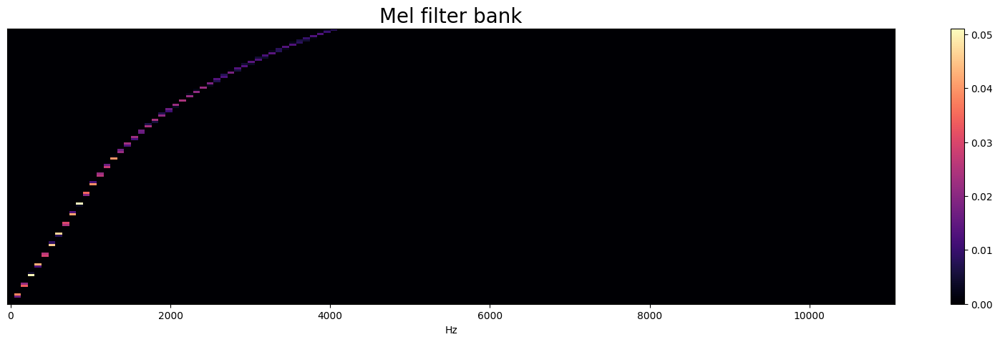

In [ ]:
fmax_dataset = 4096
mel_basis = librosa.filters.mel(sr=sr_agent, n_fft=256, n_mels=128, fmax=fmax_dataset)

plt.figure(figsize=(20,5))
librosa.display.specshow(mel_basis, x_axis='linear',fmax=fmax_dataset)
plt.title('Mel filter bank', fontsize=20)
plt.colorbar()
plt.show()

We will use this helper function to visualize your merged audio file. Note the keywords used below. First we will set the max frequency considered for our mel scale (`fmax`) to the max possible frequency for this sampling rate (Nyquist Frequency, `sample_rate/2`). The number of bins is effectively the "resolution" in mel scale of the vertical axis.

In [ ]:
# helper function to plot a mel spectrogram
# arguments: (wave array, sampling rate, number of mel bins, max frequency of mel scale)
def plot_melspectrogram(wav, sr, annotations=None, n_mels=256, fmax=4096,
                        fig=None, ax=None, show_legend=True):

    if ax == None:
      fig, ax = plt.subplots(1,1,figsize=(20,5))
    M = librosa.feature.melspectrogram(y=wav, sr=sr, n_mels=n_mels, fmax=fmax, n_fft=2048)
    M_db = librosa.power_to_db(M, ref=np.max)
    img = librosa.display.specshow(M_db, y_axis='mel', x_axis='time', ax=ax, fmax=fmax)
    if show_legend:
      ax.set(title='Mel spectrogram display')
      fig.colorbar(img, ax=ax, format="%+2.f dB")

    # iterate over list of text annotations and draw them
    if annotations is not None:
        for x,y,text in annotations:
            ax.annotate(
            text,
            xy=(x,y), xycoords='data',
            xytext=(10, -50), textcoords='offset pixels',
            horizontalalignment='right',
            color='white',
            fontsize=20,
            verticalalignment='bottom',
            arrowprops=dict(
                arrowstyle= '-|>',
                 color='white',
                 lw=1,
                 ls='-')
            )

Now we can use the helper function to visualize a Mel spectrogram of the combined audio file you created

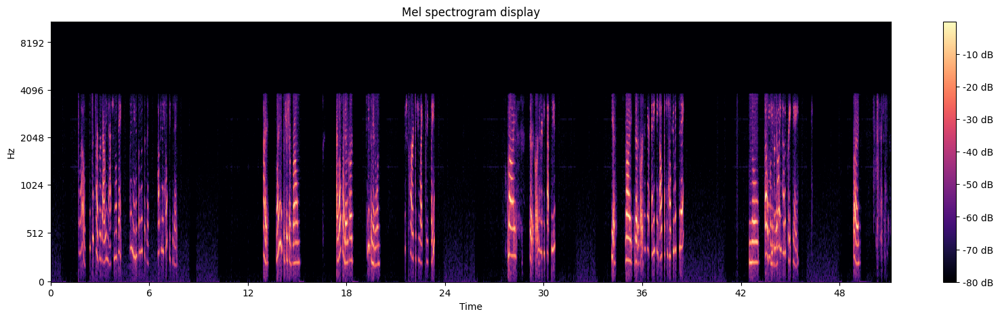

In [ ]:
plot_melspectrogram(merged_wav, sr_agent, annotations=None, n_mels=256, fmax=sr_agent/2)

Notice there is no energy above 4kHz. The dataset was collected using telephone speech, which has a sampling rate of 8kHz. Therefore the highest meaningful frequency in these recordings is 4kHz. Use the plotting arguments below as your default when displaying audio to hand in. For convenience we also set these as the default for the helper function.

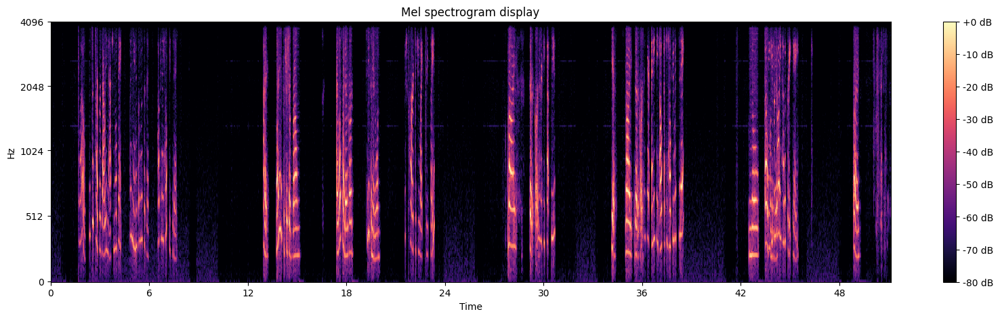

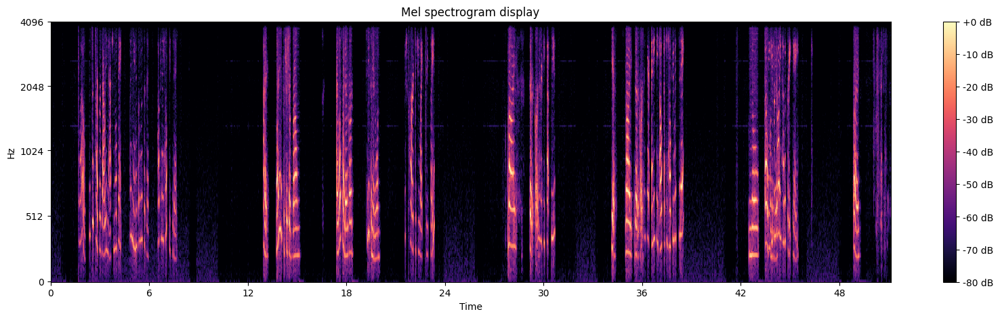

In [ ]:
# we can adjust the keyword arguments
fmax_dataset = 4096
plot_melspectrogram(merged_wav, sr_agent, annotations=None, n_mels=256, fmax=fmax_dataset)
plot_melspectrogram(merged_wav, sr_agent)

## **Task: Silence removal** (4 points)

We often analyze utterances from a single speaker at a time, rather than the conversation. We also want to focus on the actual _speech_ audio rather than long silences / pauses between utterances.

Focusing on the **agent**, your task is to remove most of the major silences from the raw waveform file. This will collapse all of the agent's utterances into a single array with just short pauses between utterances. Removing silences in this way helps focus on the speech parts of an audio file. Sometimes this process is called _voice activity detection_ (and is more dificult in scenarios with strong background noise or distortion when speech can be hard to identify from the background).

One way to do this:

1. Use `librosa.effects.split` to split the agent .wav file by silence.
2. Clip out the silences and combine the audio back into a single array with silences removed. Ensure you aren't filtering too aggressively and clipping out actual audio.

You are free to try other approaches to silence removal. It should sound like a more or less continuous utterance stream from the speaker, but it need not be perfect. Describe your approach briefly along with the implementation.

In [ ]:
#recon_agent = None # TODO: create a NumPy array with silences removed

#############################
#### YOUR CODE GOES HERE ####

# Use librosa's split function to find non-silent intervals
# The `top_db` parameter determines the threshold (in decibels) below reference to consider as silence
non_silent_intervals = librosa.effects.split(wav_agent, top_db=55)  # threshold

# Extract non-silent segments and concatenate them into a single array
recon_agent = np.concatenate([wav_agent[start:end] for start, end in non_silent_intervals])

#############################

In [ ]:
# listen to your audio file
ipd.Audio(recon_agent, rate=sr_agent)

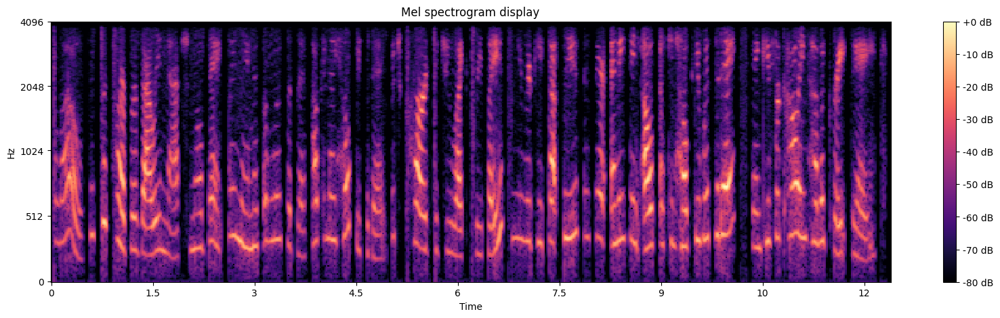

In [ ]:
# This should now have minimal gaps between utterances
# (leaving some small silences is okay)
plot_melspectrogram(recon_agent, sr_agent)

## **Task: Segment a single utterance** (2 points)

Finally, an entire audio signal is too long, so let's pick a few utterances for further work.

In the conversation above, the agent says the following: `This is Harper Valley National Bank. My name is Elizabeth. How can I help you today?`. Slice a single wave array for just this part of the utterance and visualize the corresponding spectrogram.

In [ ]:
#audio_signal =  # TODO: represent as a NumPy array

#############################
#### YOUR CODE GOES HERE ####

# Manually identified start and end times and we can tell from the above graph
# These values should be determined by listening to the audio or using a timestamp
start_time = 0.6  # start time of the utterance0.6
end_time = 4.8   # end time of the utterance

# Convert time to sample indices
start_sample = int(start_time * sr_agent)
end_sample = int(end_time * sr_agent)

# Slice the audio signal to get the desired utterance
audio_signal = recon_agent[start_sample:end_sample]

#############################

In [ ]:
# listen to your audio file
ipd.Audio(audio_signal, rate=sr_agent)

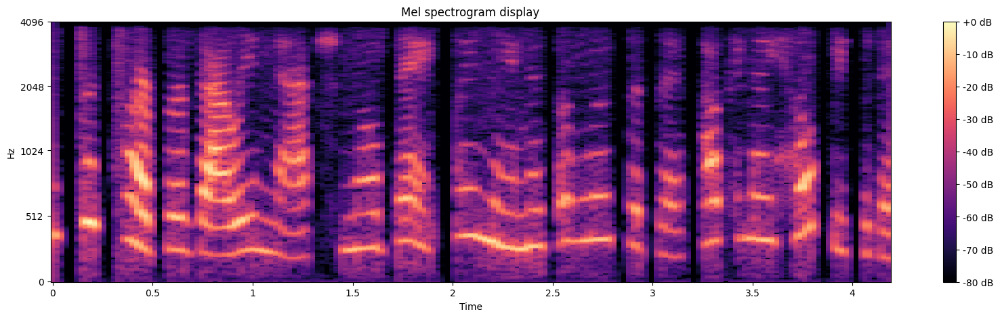

In [ ]:
plot_melspectrogram(audio_signal, sr_agent)

## **Task: Label words in the spectrogram** (5 points)

We know the true _transcript_ for this utterance, but it's also important to build an understanding of how words and phonemes appear in a spectrogram representation. This assists when debugging spoken language systems, and especially when building text to speech engines.

Using the helper function we created, you can add text labels to the spectrogram plot. Here is a single annotation to demonstrate the format:

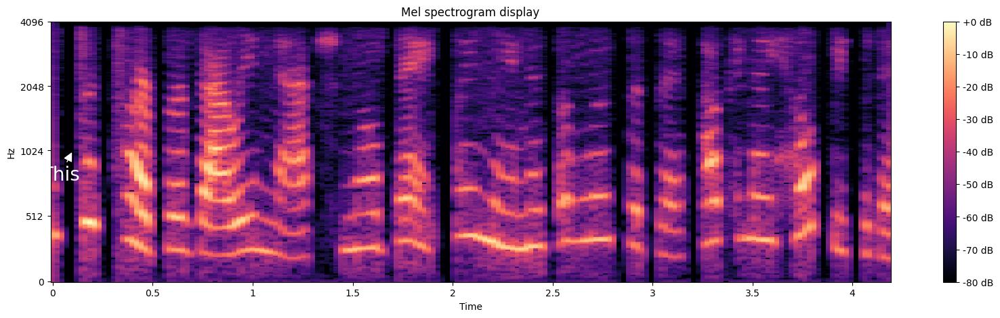

In [ ]:
utt_words = [(0.1, 1024, 'This'),]
plot_melspectrogram(audio_signal, sr_agent, annotations=utt_words)

Your task is to label all remaining words in the utterance. Try to position each annotation at the center of each word in time (x axis). You may place the word anywhere along the frequency axis for readability. We won't check the time positions of your labels precisely, just point to each word without words overlapping when displayed.

Position text anywhere along the frequency (y) axis to avoid text overlap, there is no "correct" answer on where to position words along this axis, only the time axis.

In [ ]:
# TODO: Position the remaining words correctly using the same format:
#  (time (s), frequency(Hz), annotation(string))
utt_words = [(0.1, 1024, 'This'),]
#############################
#### YOUR CODE GOES HERE ####
# these values are customized based on the rough position of each word in the spectrogram
utt_remaining_words = [
    (0.02, 1024, 'This'),
    (0.2, 1024, 'is'),
    (0.4, 1800, 'Harper'),
    (0.8, 1024, 'Valley'),
    (1.2, 1024, 'National'),
    (1.5, 1024, 'Bank'),
    (1.8, 1000, 'My'),
    (2.1, 1024, 'name'),
    (2.3, 1500, 'is'),
    (2.6, 1024, 'Elizabeth'),
    (2.9, 1000, 'How'),
    (3.1, 1024, 'can'),
    (3.3, 1024, 'I'),
    (3.55, 1024, 'help'),
    (3.8, 1024, 'you'),
    (4.1, 1024, 'today')
]

#############################

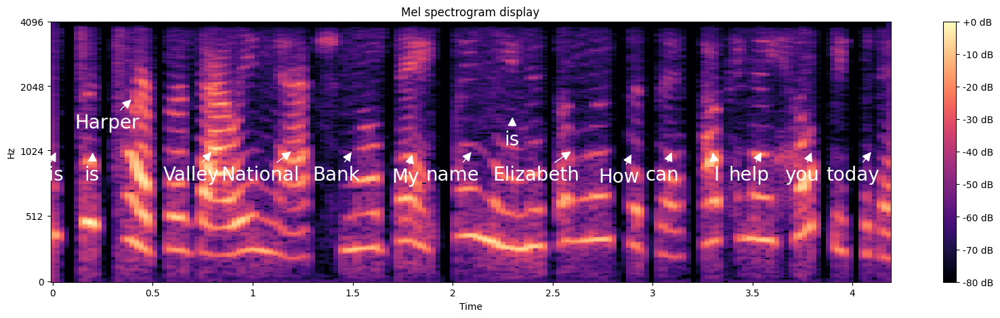

In [ ]:
#plot_melspectrogram(audio_signal, sr_agent, annotations=utt_words)
plot_melspectrogram(audio_signal, sr_agent, annotations=utt_remaining_words)

## **Task: Visually estimate mean F_0** (1 point)

F_0 is the fundamental frequency of a speaker (corresponding to the lowest harmonic of the speaker's glottal pulse train). On a Mel spectrogram, F_0 appears as the lowest frequency "line" of high energy in _voiced_ regions of speech (when the glottis is producing sound)

Visually estimate the mean F_0 frequency during the word national. Does the F_0 curve have high variance during this word? (it's okay if your F_0 estimate isn't exact.)

```
Your answer here
Look at the spectrogram, the F_0 line can be identified as a brighter,
continuous line in the lower frequency region (below 1000 Hz) during this segment.
In the context of the spectrogram, it looks like the F_0 frequency is fluctuating
but generally appears to be around 250 Hz based on the brightness of the line in that region.
```

# Visualizing alternative audio representations

We've been visualizing our utterances in Mel Spectrograms because it is easier to "read" speech-relevant phones in this view. Now let's look at the raw waveform time series plot itself. We will use the same `audio_signal` waveform in all the exercises below.

In [ ]:
def show_waveplot(audio_signal,sr,annotations=None):
    fig, ax = plt.subplots(1,1,figsize=(20,5))
    # librosa.display.waveplot(audio_signal, sr=sr)
    librosa.display.waveshow(audio_signal, sr=sr)
    # iterate over list of text annotations and draw them
    if annotations is not None:
        for x,y,text in annotations:

            ax.annotate(
            text,
            xy=(x,y), xycoords='data',
            xytext=(10, -50), textcoords='offset pixels',
            horizontalalignment='right',
            color='black',
            fontsize=20,
            verticalalignment='bottom',
            arrowprops=dict(
                arrowstyle= '-|>',
                 color='black',
                 lw=1,
                 ls='-')
            )

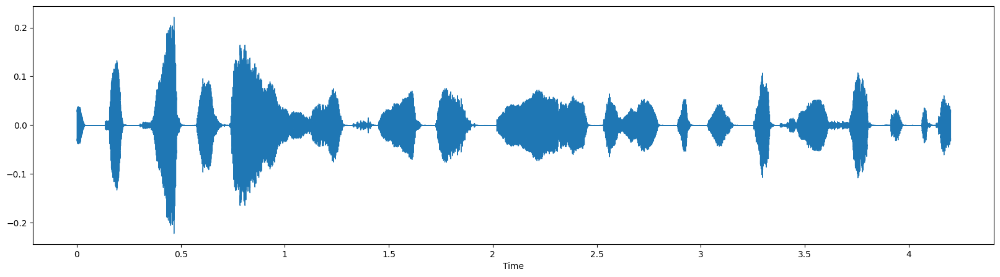

In [ ]:
show_waveplot(audio_signal,sr_agent)

## **Task: Label words in the time domain plot** (2 points)

Populate word-level annotations for the time domain plot. You should be able to use the same time annotations from the spectrogram plot. However you will need to adjust the y axis positions for words (again precise positions on the vertical axis are not graded, just try to prevent overlapping words)

In [ ]:
#  (time (s), amplitude, annotation(string))
utt_words = [(0.1, 0, 'This'),]
#############################
#### YOUR CODE GOES HERE ####
utt_remaining_words2 = [
    (0.02, 0, 'This'),
    (0.2, 0.1, 'is'),
    (0.4, -0.1, 'Harper'),
    (0.8, 0.1, 'Valley'),
    (1.2, 0, 'National'),
    (1.5, 0, 'Bank'),
    (1.8, 0, 'My'),
    (2.1, 0, 'name'),
    (2.3, 0, 'is'),
    (2.6, -0.15, 'Elizabeth'),
    (2.9, 0, 'How'),
    (3.1, 0, 'can'),
    (3.3, 0, 'I'),
    (3.55, 0, 'help'),
    (3.8, 0, 'you'),
    (4.1, 0, 'today')
]


#############################

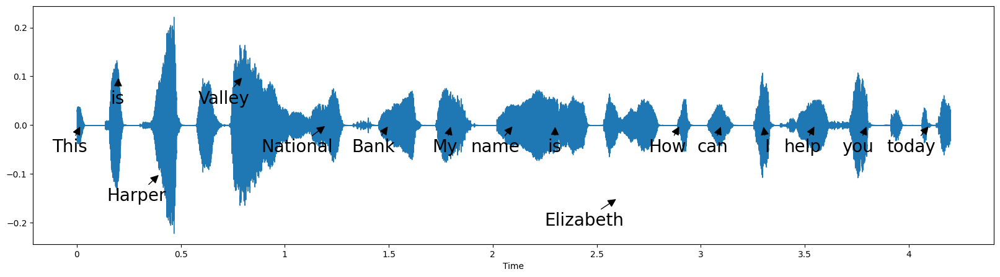

In [ ]:
show_waveplot(audio_signal,sr_agent,utt_remaining_words2)

Answer a few followup questions in text below:
1. Describe what aspects of speech you can infer in this time series plot compared to the Mel spectrum above. Compare the two, when might looking at one vs the other help when working with audio data?
2. Does each word have a distinct segment in the time-amplitude plot? (A segment in this context is portion of the waveform clearly larger than 0)
3. Specify a word that has more than one distinct segment in the time-amplitude plot.


```
Your response here
1. we can infer the intensity (loudness) of the speech and highlights the segments of voiced and unvoiced sounds by looking
at the amplitude of the audio signal over time.
But the spectrogram provides information about the frequency content of the speech signal over time.
It shows different frequencies contribute to the audio signal,
so we can get its harmonic structure.
When to Use Each Representation
Use the Time-Amplitude Plot When we want to analyze the amplitude of the audio signal, identify distinct words or segments.
Use the Mel Spectrogram When we need to analyze the frequency content and pitch variations (F_0) over time.
and when we are interested in the voiced and unvoiced segments or need to extract their features.
2. Each word does generally have a distinct segment in the time-amplitude plot, because some waveforms are clearly larger than zero.
3. Example of a Word with More than One Distinct Segment: The word "National" exhibits two distinct segments.
This can be seen as the waveform shows notable amplitude levels for the phonemes associated with "National".
```

## Mel frequency cepstral coefficients (MFCCs)

MFCCs are a prominent feature choice for speech recognition and related tasks, especially when using Gaussian Mixture Models (GMMs) for acoustic modeling (we will cover this in our speech recognition section).

While less popular for modern speech processing with neural networks, they are commonly used with more traditional statistical methods and you will likely encounter this feature representation when working with different speech tools.

A [cepstrum](https://en.wikipedia.org/wiki/Cepstrum) is a spectrum of a spectrum (e.g. nested fourier transform). MFCCs are a cepstral representation of the Mel spectrum. Usually, to compute MFCCs, you first do a fourier transform on the audio waveform, map to the Mel scale, followed by a second transform.

MFCCs are a popular choice in speech modeling because they produce approximately independent feature dimensions. This allows us to simplify acoustic modeling assumptions by assuming a diagonal covariance matrix for MFCCs (rather than modeling the full covariance structure of the features).

### **Task: Compute MFCC features** (3 points)

Use `librosa.feature` to compute and plot the MFCC for the `audio_signal` waveform. Use a `hop_length` of 512 and 32 cepstral coefficients. Once you compute the MFCCs we provide code to plot the MFCCs, and then _invert_ the MFCC transform to view the MFCCs as a Mel spectrogram again. Once you have this working, describe what differences you observe between the original log Mel spectrogram and the one recovered from your MFCC features.

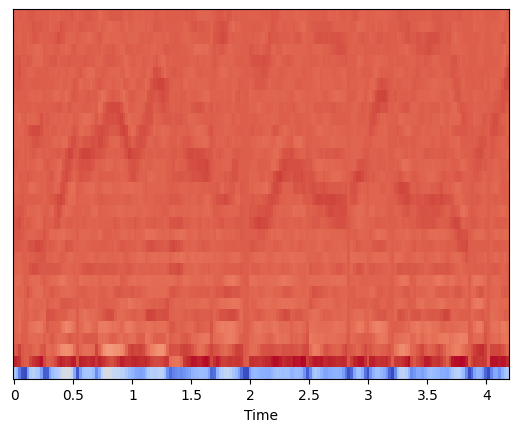

In [ ]:
mfcc_feats = None #TODO fill this in
# start with these Mel spectrograms so MFCC computes only the final transform
# alternatively you can compute MFCCs from the orignal waveform but ensure you pass
#   arguments to .mfcc() to match our Mel Spectrogram processing above
mel_feats = librosa.feature.melspectrogram(y=audio_signal, sr=sr_agent,
                                           n_mels=256, fmax=4096, n_fft=2048)
log_mel_feats = librosa.power_to_db(mel_feats, ref=np.max)

#############################
#### YOUR CODE GOES HERE ####

# Compute MFCCs using librosa
mfcc_feats = librosa.feature.mfcc(S=log_mel_feats, sr=sr_agent, n_mfcc=32, hop_length=512)


#############################

# This will display your MFCCs. We do not expect this to be a meaningful visual
# We only use this plot to check your MFCC values while grading
librosa.display.specshow(mfcc_feats, x_axis='time')

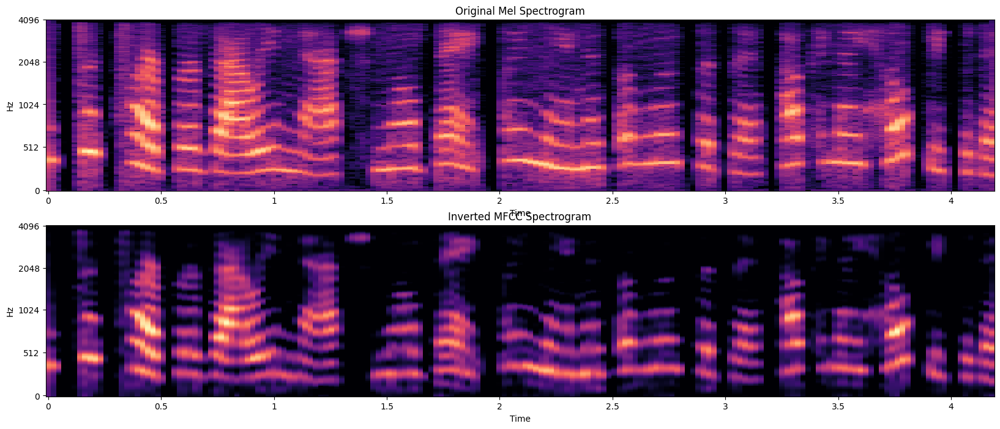

In [ ]:
fig, ax = plt.subplots(2,1,figsize=(20,8))
librosa.display.specshow(log_mel_feats,
                         x_axis='time', y_axis='mel', fmax=4096, ax=ax[0])
ax[0].set_title('Original Mel Spectrogram')

# this inverts the MFCC transform, takes the log of the Mel spectrum, and plots
librosa.display.specshow(librosa.power_to_db(librosa.feature.inverse.mfcc_to_mel(mfcc_feats),
                                             ref=np.max),
                         x_axis='time', y_axis='mel', fmax=4096, ax=ax[1])
ax[1].set_title('Inverted MFCC Spectrogram')
plt.show()


Describe what differences you observe between the original Mel spectrogram and the spectrogram recovered from inverting the MFCC feature transform.


```
Your response here
1. Because MFCC computation is lossy and doesn't fully preserve some original spectrogram info (like phase).
The original Mel spectrogram and the recovered one from MFCCs differ in finer details and resolution.
The recovered spectrogram still have smoothed features after inversion.
2. Recovered one involves more distortions or missings in high-frequency parts.
```


# Pitch estimation and warping

Earlier we roughly estimated F_0 by visually inspecting the spectrogram. There are a range of algorithms to robustly, automatically extract the _pitch track_ of an utterance. Here is an example of F_0 extraction using the [SWIPE](https://citeseerx.ist.psu.edu/viewdoc/download?doi=10.1.1.324.4466&rep=rep1&type=pdf) algorithm.

In [ ]:
# our calls are loaded with a sampling rate of 22kHz.
# 1024 hop size means we compute a pitch estimate approxiately every .046 seconds
pitch_hop = 1024
voicing_threshold = 0.3
f0_swipe = pysptk.swipe(audio_signal, fs=sr_agent, hopsize=pitch_hop,
                        min=60, max=512, otype="f0", threshold=voicing_threshold)


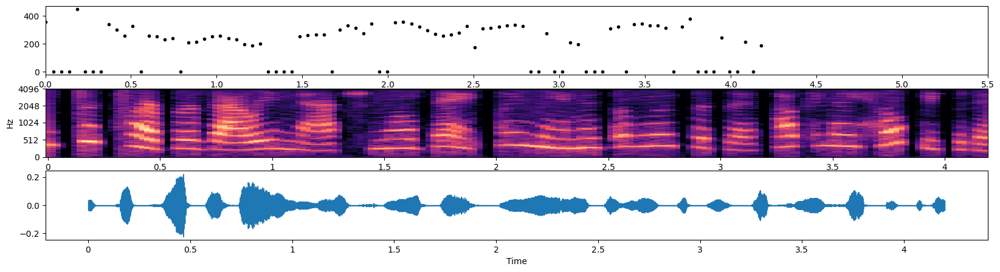

In [ ]:
time_labels = (pitch_hop / sr_agent) * np.arange(len(f0_swipe))

fig, ax = plt.subplots(3,1,figsize=(20,5))
ax[0].plot(time_labels, f0_swipe, 'k.')
ax[0].set_xlim([0, time_labels[-1]])
ax[0].set_xticks(np.arange(6.0, step=0.5))
#ax[0].set_xticks(np.arange(4.4, step=0.5))

plot_melspectrogram(audio_signal, sr_agent, annotations=None, n_mels=256,
                    fmax=4096, fig=fig, ax=ax[1], show_legend=False)
librosa.display.waveshow(audio_signal, sr=sr_agent, ax=ax[2])

## **Task: Try pitch extraction variations to improve** (10 points)

The SWIPE algorithm and parameters provided are a reasonable starting point for F_0 estimation, but not a state-of-the-art approach. Pitch estimation algorithms are often sensitive to background noise and recording conditions.

Try at least two alternative settings for the SWIPE extractor, or go further and experiment with a different pitch estimation algorithm.
1. Overlay your different estimates on the same plot
2. Describe what differences you observe
3. Explain which extractor best matches what you think is the "correct" pitch estimate for this audio and why.

Some hints:
- SWIPE can be sensitive to the choice of `voicing_threshold` which is how it separates unvoiced spoken regions (e.g. the phoneme "sh") from voiced regions
- In our example, we specify `otype=f0` to make SWIPE estimate F0. Try estimating pitch or log_f0. Remember: _pitch_ is human perception of F0 whereas F0 is the measured value of fundamental frequency.
- You can try the reaper pitch estimator from pyreaper.

In [ ]:
!pip install pyreaper
import pyreaper

hop_period = pitch_hop/sr_agent
audio_signal_int16 = np.int16(np.round(audio_signal * 32767))
[pm_times, pm, f0_times, f0_reaper, corr] = pyreaper.reaper(x=audio_signal_int16,fs=sr_agent,minf0=60, maxf0=512,frame_period=hop_period)

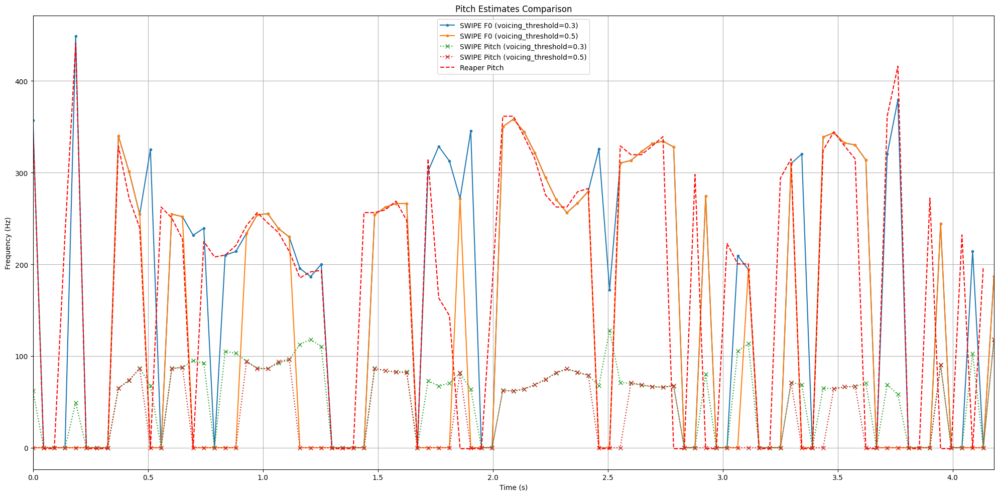

In [ ]:
#############################
#### YOUR CODE GOES HERE ####

# Define pitch estimation parameters
pitch_hop = 1024
f0_min = 60
f0_max = 512

# SWIPE settings
voicing_thresholds = [0.3, 0.5] # Experimenting with two different thresholds
f0_swipe_f0 = []
f0_swipe_pitch = []

# SWIPE pitch extraction with different voicing thresholds
for threshold in voicing_thresholds:
  f0_swipe_f0.append(pysptk.swipe(audio_signal, fs=sr_agent, hopsize=pitch_hop,
                                  min=f0_min, max=f0_max, otype="f0", threshold=threshold))
  f0_swipe_pitch.append(pysptk.swipe(audio_signal, fs=sr_agent, hopsize=pitch_hop,
                                     min=f0_min, max=f0_max, otype="pitch", threshold=threshold))

# Use the Reaper pitch estimator
# Convert audio signal to int16 for PyReaper
audio_signal_int16 = np.int16(np.round(audio_signal * 32767))
hop_period = pitch_hop / sr_agent
pm_times, pm, f0_times, f0_reaper, corr = pyreaper.reaper(
    x=audio_signal_int16, fs=sr_agent, minf0=f0_min, maxf0=f0_max, frame_period=hop_period)

# Generate time labels for the plots
time_labels = (pitch_hop / sr_agent) * np.arange(len(f0_swipe_f0[0]))

# Create a figure to plot the results
plt.figure(figsize=(20, 10))

# Plot SWIPE estimates for F0 and pitch
for i, f0_swipe in enumerate(f0_swipe_f0):
   plt.plot(time_labels, f0_swipe, '.',linestyle='-', label=f'SWIPE F0 (voicing_threshold={voicing_thresholds[i]})')

for i, f0_swipe in enumerate(f0_swipe_pitch):
    plt.plot(time_labels, f0_swipe, 'x',linestyle=':', label=f'SWIPE Pitch (voicing_threshold={voicing_thresholds[i]})')

# Plot Reaper estimates
plt.plot(f0_times, f0_reaper, label='Reaper Pitch', linestyle='--', color='red')

# Adding labels and legend
plt.title('Pitch Estimates Comparison')
plt.xlabel('Time (s)')
plt.ylabel('Frequency (Hz)')
plt.xlim([0, time_labels[-1]])
plt.legend()
plt.grid()
plt.tight_layout()
plt.show()


#############################

```
Pitch Estimation Comparison

The SWIPE F0 algorithm, when using lower threshold of 0.3, produces a detailed pitch estimate but is prone to noise artifacts.
Increasing the threshold to 0.5 yields a cleaner estimate but may miss some valid pitch segments.

As for SWIPE pirch, this estimate appears to have smoother transitions and avoids many of the extreme fluctuations seen in the
lower threshold. It may sacrifice some accuracy for a cleaner output, leading to more stable pitch tracking.

The Reaper pitch estimates likely provide the best match for what could be considered the "correct" pitch estimate, especially if
the audio signal is noisy or contains frequent unvoiced sounds. It maintains stability in both voiced and unvoiced section.
```

## Pitch warping

One thing we often do with speech data is shift pitches. This could be used as data augmentation technique (e.g. to prevent overfitting when training neural networks) or as standardization technique to obscure speaker identity (e.g. for privacy purposes, or to make a system more robust to many different speakers).

In [ ]:
# recall our original snippet
ipd.Audio(audio_signal, rate=sr_agent)

We can use the `librosa.effects` library to shift our sample up and down. See the examples below and listen to the shifted samples.

In [ ]:
# shift up by four half steps
audio_u4hs = librosa.effects.pitch_shift(audio_signal, sr=sr_agent, n_steps=4)
ipd.Audio(audio_u4hs, rate=sr_agent)

In [ ]:
# shift down by six half steps
audio_d6hs = librosa.effects.pitch_shift(audio_signal, sr=sr_agent, n_steps=-6)
ipd.Audio(audio_d6hs, rate=sr_agent)

### **Task: Extract and plot F0 for pitch-shifted examples** (5 points)

Using the pitch extraction routine you refined above, plot the extracted F0 or pitch for the original, up-shifted, and down-shifted utterances.

Describe how the extracted pitch estimates change, and any adjustments you needed to make to your pitch extraction settings.

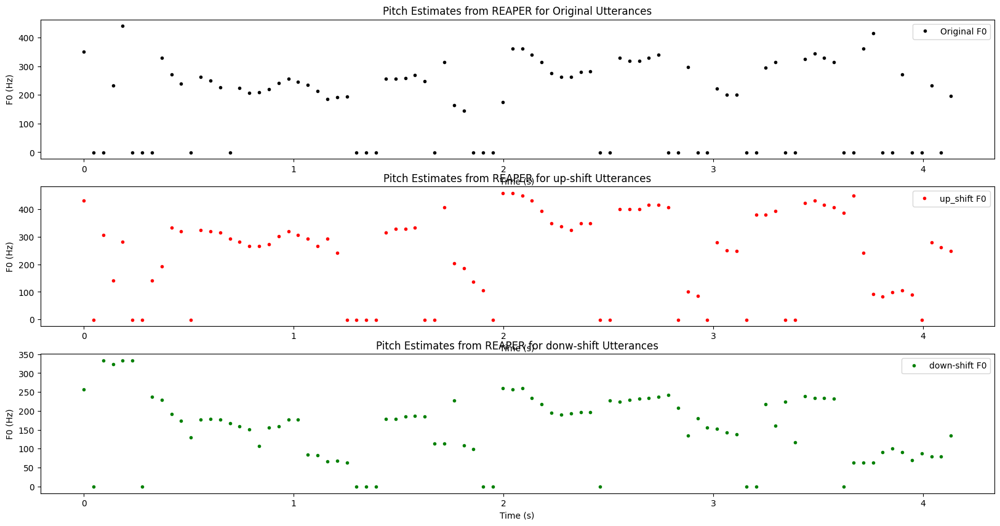

In [ ]:
#############################
#### YOUR CODE GOES HERE ####

#get original fundamental frequency
#And extract F0 using REAPER for all three utterances
#hop_period = pitch_hop / sr_agent
audio_signal_int16 = np.int16(np.round(audio_signal * 32767))
[_, _, f0_times, f0_reaper_orig, corr] = pyreaper.reaper(x=audio_signal_int16,fs=sr_agent,minf0=60, maxf0=512,frame_period=hop_period)

# get up-shift one
audio_u4hs_int16 = np.int16(np.round(audio_u4hs * 32767))
[_, _, f0_times, f0_reaper_u4hs, corr] = pyreaper.reaper(x=audio_u4hs_int16,fs=sr_agent,minf0=60, maxf0=512,frame_period=hop_period)

# get down-shift one
audio_d6hs_int16 = np.int16(np.round(audio_d6hs * 32767))
[_, _, f0_times, f0_reaper_d6hs, corr] = pyreaper.reaper(x=audio_d6hs_int16,fs=sr_agent,minf0=60, maxf0=512,frame_period=hop_period)

# Time labels for the x-axis
time_labels = (pitch_hop / sr_agent) * np.arange(len(f0_reaper_orig))

# Create plots
fig, ax = plt.subplots(3, 1, figsize=(20, 10))

# Plotting REAPER F0 estimates for original, up-shifted, and down-shifted
orig_index = ~np.isnan(f0_reaper_orig)
up_index = ~np.isnan(f0_reaper_u4hs)
down_index = ~np.isnan(f0_reaper_d6hs)
ax[0].plot(f0_times[orig_index], f0_reaper_orig[orig_index], 'k.', label='Original F0')

ax[0].set_title('Pitch Estimates from REAPER for Original Utterances')
ax[0].set_ylabel('F0 (Hz)')
ax[0].set_xlabel('Time (s)')
ax[0].legend()

#
ax[1].plot(f0_times[orig_index], f0_reaper_u4hs[orig_index], 'r.', label='up_shift F0')
ax[1].set_title('Pitch Estimates from REAPER for up-shift Utterances')
ax[1].set_ylabel('F0 (Hz)')
ax[1].set_xlabel('Time (s)')
ax[1].legend()
#
ax[2].plot(f0_times[orig_index], f0_reaper_d6hs[orig_index], 'g.', label='down-shift F0')
ax[2].set_title('Pitch Estimates from REAPER for donw-shift Utterances')
ax[2].set_ylabel('F0 (Hz)')
ax[2].set_xlabel('Time (s)')
ax[2].legend()

#############################

```
Description:
```
 The pitch estimates (F0) fluctuate between 0 Hz and approximately 480 Hz.

Up-Shifted Utterances (Middle Plot): The values are generally higher compared to the original utterances, with some generally increased estimates. This suggests that the overall mean pitch is elevated.

Down-Shifted Utterances (Bottom Plot): The pitch estimates here are lower than the original utterances. the frequency range decrease almost 100Hz. Similar to the up-shifted plot, the fluctuations in pitch are present, but the overall trend has shifted downwards.

To achieve the desired pitch extraction results, certain adjustments may have been necessary, such as: Voicing Threshold: Adjusting the voicing threshold can help better differentiate between voiced and unvoiced sounds. Hop Size: Modifying the hop size (time between pitch estimates) could affect the smoothness of the pitch plot.

# Synthesizing from Mel spectral envelopes

Finally, let's use re-synthesis to have some fun! Re-synthesis is a great way to establish a baseline when building text to speech (TTS) systems, or other audio transforms. Essentially we convert audio into some (lossy) representation, and then attempt to recover the original audio by transforming it back. This can help set expectations for TTS development because it helps us debug which parts of our signal processing might impose limits on naturalness of the produced audio.

Here is a helper function to transform audio to mel cepstrum then re-synthesize a wave. You do not need to understand all steps here. pysptk uses low-level signal processing routines we won't cover in detail. More on this in our TTS lectures!

In [ ]:
# arguments: (wave array, sampling rate, number of mel bins, max frequency of mel scale)
def resynth_audio(wav, sr_orig, sr_tosynth=8192):
  order = 25
  alpha = 0.41
  frame_length = 512
  hop_length = 40

  # resample audio signal to 8kHz for easier work with pysptk synth tools
  # pysptk does not set a max frequency when computing the mel cepstrum features
  # thus it's easier to resample the audio so that sample_rate = 2*max_frequency
  signal_to_synth = librosa.resample(wav, orig_sr=sr_orig, target_sr=sr_tosynth)

  # frames used in computing MFCCs in pysptk
  frames = librosa.util.frame(signal_to_synth, frame_length=frame_length,
                              hop_length=hop_length).astype(np.float64).T
  # Windowing
  frames *= pysptk.blackman(frame_length)

  mc = pysptk.mcep(frames, order, alpha, etype=1, eps=1e-8)
  logH = pysptk.mgc2sp(mc, alpha, 0.0, frame_length).real

  librosa.display.specshow(logH.T, sr=sr_tosynth, hop_length=hop_length, x_axis="time", y_axis="linear")
  plt.colorbar()
  plt.show()

  # Convert mel-cesptrum (MFCC) to MLSADF coefficients
  b = pysptk.mc2b(mc, alpha)

  # extract pitch
  pitch = pysptk.swipe(signal_to_synth.astype(np.float64), fs=sr_tosynth,
                       hopsize=hop_length, min=60, max=300, otype="pitch")
  source_excitation = pysptk.excite(pitch, hop_length)

  synthesizer = Synthesizer(MLSADF(order=order, alpha=alpha), hop_length)

  x_synthesized = synthesizer.synthesis(source_excitation, b)
  return x_synthesized

Helper function to record your own audio. You'll need to grant microphone access in your browser and have a working microphone for this to work

In [ ]:
RECORD = """
const sleep  = time => new Promise(resolve => setTimeout(resolve, time))
const b2text = blob => new Promise(resolve => {
  const reader = new FileReader()
  reader.onloadend = e => resolve(e.srcElement.result)
  reader.readAsDataURL(blob)
})
var record = time => new Promise(async resolve => {
  stream = await navigator.mediaDevices.getUserMedia({ audio: true })
  recorder = new MediaRecorder(stream)
  chunks = []
  recorder.ondataavailable = e => chunks.push(e.data)
  recorder.start()
  await sleep(time)
  recorder.onstop = async ()=>{
    blob = new Blob(chunks)
    text = await b2text(blob)
    resolve(text)
  }
  recorder.stop()
})
"""

def record(sec=5):
  try:
    from google.colab import output
  except ImportError:
    print('No possible to import output from google.colab')
    return ''
  else:
    print('Recording')
    display(ipd.Javascript(RECORD))
    s = output.eval_js('record(%d)' % (sec*1000))
    fname = 'recorded_audio.wav'
    print('Saving to', fname)
    b = b64decode(s.split(',')[1])
    with open(fname, 'wb') as f:
      f.write(b)
    return fname

Here is an example of resynthesizing our test utterance.

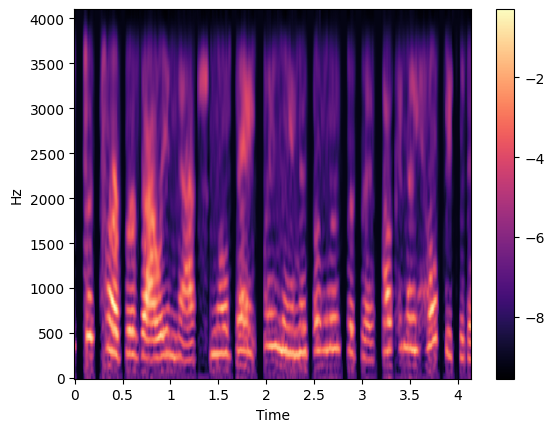

In [ ]:
synth_sr = 8192
synth_wav = resynth_audio(audio_signal, sr_agent, synth_sr)

ipd.Audio(synth_wav, rate=synth_sr)

## **Task: Record yourself and resynthesize your utterance!** (5 points)

In [ ]:
# record yourself speaking!
# If this fails you can record using a system utility and upload the .wav file
record(5)

utterances = [
    
    "He is the most handsome boy in the world.",
    "she can’t believe it’s so expensive!",
    "I am over the moon,lol",
    "I’m feeling a bit under the weather today.",
    "Can you tell me the time, please?"
]


In [ ]:
# convert the file format from not actually a wav to a wav
#!ffmpeg -y -i ./recorded_audio.wav out.wav
!ffmpeg -y -i /content/Mysound.m4a out.wav # I recored by my pc and then transfer .m4a format to .wav

ffmpeg version 4.4.2-0ubuntu0.22.04.1 Copyright (c) 2000-2021 the FFmpeg developers
  built with gcc 11 (Ubuntu 11.2.0-19ubuntu1)
  configuration: --prefix=/usr --extra-version=0ubuntu0.22.04.1 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --arch=amd64 --enable-gpl --disable-stripping --enable-gnutls --enable-ladspa --enable-libaom --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libcodec2 --enable-libdav1d --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libjack --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librabbitmq --enable-librubberband --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libsrt --enable-libssh --enable-libtheora --enable-libtwolame --enable-libvidstab --enable-libvorbis --enable-libvpx --enab

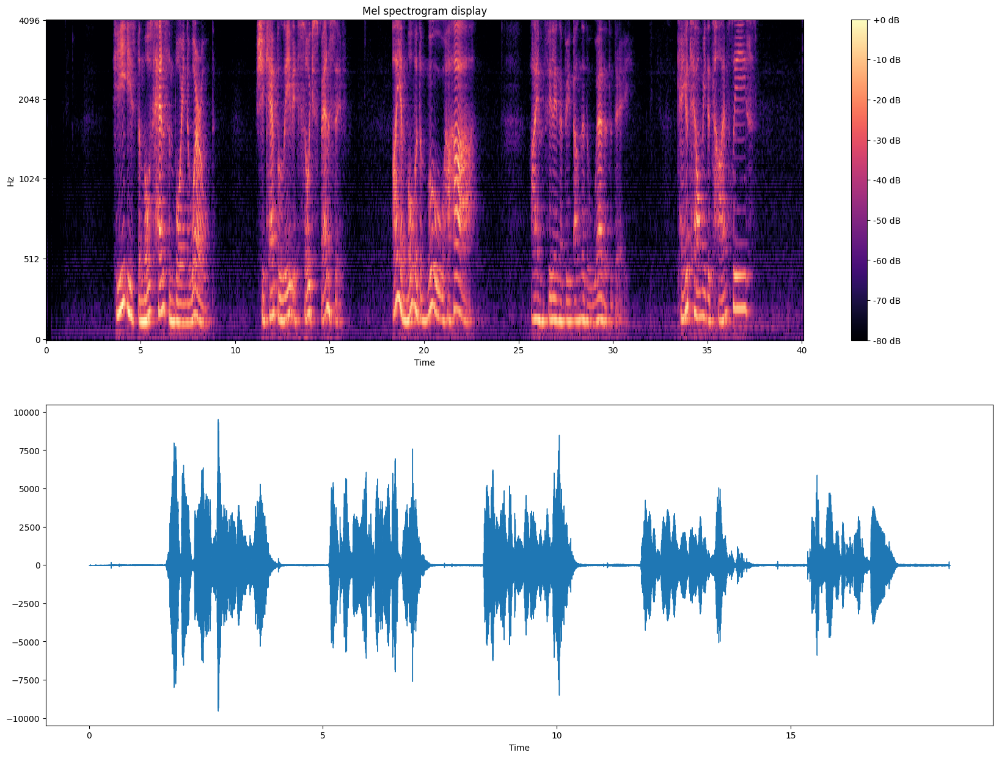

In [ ]:
from scipy.io import wavfile
import numpy as np
# Play your audio file to verify it worked
sr, dat = wavfile.read("./out.wav")
# Split out to view one channel
l_ch = dat[:, 0]

# plot the audio channel
fig, ax = plt.subplots(2,1,figsize=(20,15))
plot_melspectrogram(l_ch.astype(np.float32), sr=sr, ax=ax[0], fig=fig, n_mels=196)
librosa.display.waveshow(l_ch.astype(np.float32), sr=sr, ax=ax[1])

ipd.Audio(l_ch, rate=sr)

In [ ]:
# it's okay to see a warning about PySoundFile here.
# It's due to the saved format of the recorded wav file
#wav_mine, sr_mine = librosa.load('recorded_audio.wav')
wav_mine, sr_mine = librosa.load('/content/out.wav')

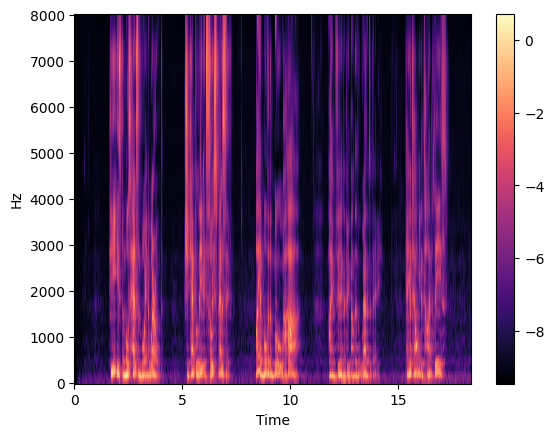

In [ ]:
synth_sr = 16000
synth_wav = resynth_audio(wav_mine, sr_mine, synth_sr)

ipd.Audio(synth_wav, rate=synth_sr)

( Describe what differences you notice between your original audio and the re-synthesized audio. If you can't get recording your voice to work, you may describe differences for the agent utterance above. )


```
Your response here
The sound seems like having a magnetic sound effect, which makes the resynthesized audio not as natural as my own sound.
```

# Generating Synthetic Voices

## Using a Text-to-Speech API (**LMNT**)

### Setup

1. Create a free account on [app.lmnt.com](https://app.lmnt.com) and create an API key [here](https://app.lmnt.com/account).
2. Add the API key to your Colab Environment secrets on the left menu and enable notebook access.

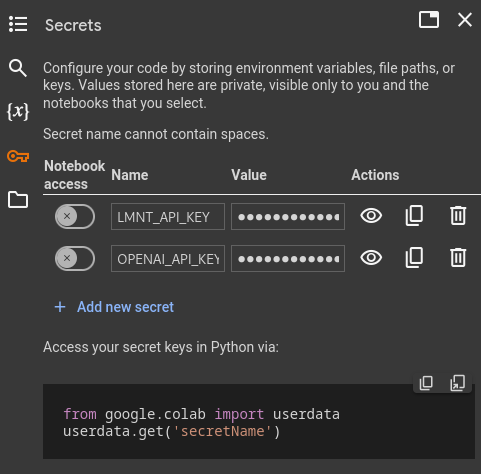



In [ ]:
# Install the lmnt sdk
!pip install lmnt

In [ ]:
# use your API key
from google.colab import userdata
LMNT_API_KEY = userdata.get("LMNT_API_KEY")

assert LMNT_API_KEY is not None and LMNT_API_KEY != ""

### Synthesize a Voice

In [ ]:
# Let's choose a voice to use from the API
from pprint import pprint
from lmnt.api import Speech

async with Speech(api_key=LMNT_API_KEY) as speech:
    voices = await speech.list_voices()
    pprint(voices)

[{'description': 'US. Young adult. Excited. Conversational',
  'gender': 'F',
  'id': 'amy',
  'name': 'Amy',
  'owner': 'system',
  'starred': False,
  'state': 'ready',
  'type': 'professional'},
 {'description': 'US. Middle-aged. Sultry. Narrative',
  'gender': 'F',
  'id': 'ava',
  'name': 'Ava',
  'owner': 'system',
  'starred': False,
  'state': 'ready',
  'type': 'professional'},
 {'description': 'US. Young adult. Most conversational',
  'gender': 'M',
  'id': 'caleb',
  'name': 'Caleb',
  'owner': 'system',
  'starred': False,
  'state': 'ready',
  'type': 'professional'},
 {'description': 'US. Young adult. Conversational',
  'gender': 'F',
  'id': 'chloe',
  'name': 'Chloe',
  'owner': 'system',
  'starred': False,
  'state': 'ready',
  'type': 'professional'},
 {'description': 'US-Southern. Middle-aged. Narrative. Video games',
  'gender': 'M',
  'id': 'dalton',
  'name': 'Dalton',
  'owner': 'system',
  'starred': False,
  'state': 'ready',
  'type': 'professional'},
 {'desc

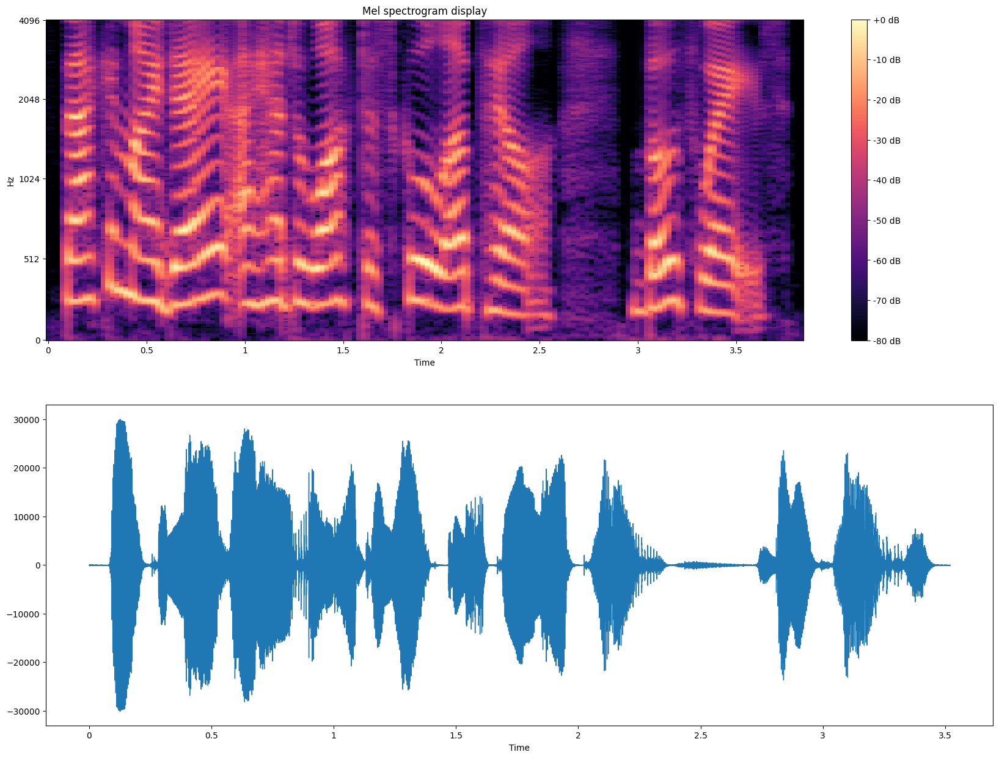

In [ ]:
from IPython.display import Audio
from scipy.io import wavfile
import io
import librosa
import numpy as np

# # for this example, we will try Eleanor's voice. Feel free to modify this.
# voice = next((v for v in voices if v["name"] == "Eleanor"))

# modified one
voice = next((v for v in voices if v["name"] == "Lily"))

async with Speech(LMNT_API_KEY) as speech:
    response = await speech.synthesize(
        text="Back in my day, I had to walk to school uphill... both ways.",
        voice=voice["id"],
        format="wav"
        )

lmnt_audio_response = response["audio"]

fd = io.BytesIO(lmnt_audio_response)
lmnt_sr, lmnt_data = wavfile.read(fd)

# librosa only accepts f32s
lmnt_audio = lmnt_data.astype(np.float32)


# plot the audio
fig, ax = plt.subplots(2,1,figsize=(20,15))
plot_melspectrogram(lmnt_audio, lmnt_sr, fig=fig, ax=ax[0])
librosa.display.waveshow(lmnt_audio, sr=lmnt_sr, ax=ax[1])

Audio(lmnt_audio, rate=lmnt_sr)

### Task: Listening test and Mean Opinion Score (MOS) (7 points)

Human evaluations are often the best metric for TTS systems since it's difficult to automate evaluation of subtle voice features.

Generate 5 utterances using LMNT, you may choose what transcripts to use, and try to create a range of difficulties including pronunciation or emotive utterances.

For each utterance, listen to it (ideally with decent headphones/speakers) and provide a score of 1-5 (1 worst, 5 best) for each of these four categories:
- Naturalness: How natural/human does the audio sound in terms of voice quality?
- Intelligibility: Is the audio comprehensible and easy for you to understand the first time you hear it?
- Expressiveness: Is the audio expressive and does prosody/tone match what you would expect a human to express when saying the same thing?
- Overall: Your overall opinion on the quality of this TTS

Compute and report your _mean opinion score_ for each category by averaging across the five utterances.

In [ ]:
# Hard code your opinion scores for each of the five utterances here
# Compute and display your mean opinion score for each category

#############################
#### YOUR CODE GOES HERE ####
voice = next((v for v in voices if v["name"] == "Nathan"))
# Utterances
five_utterances = [
    "He is the most handsome boy in the world.",
    "she can’t believe it’s so expensive!", # surprised emtion
    "This is so hilarious, lol",  # happy
    "I’m feeling a bit under the weather today.", #sad
    "Can you tell me where is classroom, please?"
]

# define a list to store synthesized audios
synthesized_audios = []

# Define an asynchronous function to synthesize each text
async def synthesize_texts():
    async with Speech(LMNT_API_KEY) as speech:
        for text in five_utterances:
            response = await speech.synthesize(
                text=text,
                voice=voice["id"],
                format="wav"
            )
            lmnt_audio_response = response["audio"]
            fd = io.BytesIO(lmnt_audio_response)
            lmnt_sr, lmnt_data = wavfile.read(fd)
            lmnt_audio = lmnt_data.astype(np.float32)
            synthesized_audios.append((lmnt_audio, lmnt_sr, text))

# Run the asynchronous function
await synthesize_texts()
# Play and display each synthesized audio
for idx, (lmnt_audio, lmnt_sr, text) in enumerate(synthesized_audios):
    print(f"Audio Clip {idx+1}: {text}")
    display(Audio(lmnt_audio, rate=lmnt_sr))
#############################

Audio Clip 1: He is the most handsome boy in the world.


Audio Clip 2: she can’t believe it’s so expensive!


Audio Clip 3: This is so hilarious, lol


Audio Clip 4: I’m feeling a bit under the weather today.


Audio Clip 5: Can you tell me where is classroom, please?


In [ ]:
# Scores: [Naturalness, Intelligibility, Expressiveness, Overall]
scores = {
    "Utterance 1": [4, 5, 4, 4],
    "Utterance 2": [4, 4, 5, 4],
    "Utterance 3": [5, 5, 5, 5],
    "Utterance 4": [4, 4, 4, 4],
    "Utterance 5": [4, 5, 4, 4],
}

# Compute mean opinion scores for each category
mean_scores = {
    "Naturalness": np.mean([scores[u][0] for u in scores]),
    "Intelligibility": np.mean([scores[u][1] for u in scores]),
    "Expressiveness": np.mean([scores[u][2] for u in scores]),
    "Overall": np.mean([scores[u][3] for u in scores]),
}

# Display mean opinion scores
mean_scores

{'Naturalness': 4.2,
 'Intelligibility': 4.6,
 'Expressiveness': 4.4,
 'Overall': 4.2}

In my opinion, it cannot generate very natural emotive expressions, but the overall performance is very good quality

## A/B listening test evaluation

As TTS technology has matured, people are using TTS for a variety of applications including personal assistants, audiobook narration, and even video game characters. Clearly we have different needs from a TTS system depending on where it's used, including issues around cloud connectivity and system latency.

Let's imagine you have been tasked to select a TTS provider for a video game where you want several different expressive voices that sound close to a professional voice talent in terms of quality. We assume our game is always connected to the internet, and we can tolerate up to 3 seconds of latency when synthesizing an utterance.

MOS is a useful metric for TTS, but often times the best way to elicit human feedback is via a _forced choice A/B comparison_. That means presenting two options and asking the human evaluator which they prefer in terms of naturalness, expressiveness, etc.

For comparison to LMNT, let's try [rime.ai](https://rime.ai/)

### Task: A/B comparison evaluation of Rime and LMNT (3 points)

Generate five utterances using the landing page demo on [rime.ai](https://rime.ai/). Using LMNT generate a matching set of five utterances (same transcript). You many choose what voice and settings to use for both.

For each of the five utterances. Pick which system you prefer in terms of:
- Naturalness: How natural/human does the audio sound in terms of voice quality?
- Intelligibility: Is the audio comprehensible and easy for you to understand the first time you hear it?
- Expressiveness: Is the audio expressive and does prosody/tone match what you would expect a human to express when saying the same thing?
- Overall: Your overall opinion on the quality of this TTS

Report the aggregated comparison scores across your five utterances for each category. Finally, make a final recommendation of which system to use in a video game -- your final assessment can include factors related to the variation of available voices, their emotional range, etc.

In [ ]:
# Scores: [Naturalness, Intelligibility, Expressiveness, Overall]

scores = {
    "Utterance 1": [4, 5, 4, 4],
    "Utterance 2": [5, 5, 5, 5],
    "Utterance 3": [4, 5, 5, 5],
    "Utterance 4": [4, 4, 4, 4],
    "Utterance 5": [4, 5, 5, 4.5],
}

# Compute mean opinion scores for each category
mean_scores = {
    "Naturalness": np.mean([scores[u][0] for u in scores]),
    "Intelligibility": np.mean([scores[u][1] for u in scores]),
    "Expressiveness": np.mean([scores[u][2] for u in scores]),
    "Overall": np.mean([scores[u][3] for u in scores]),
}
mean_scores

{'Naturalness': 4.2,
 'Intelligibility': 4.8,
 'Expressiveness': 4.6,
 'Overall': 4.5}


```
Your response here
After listening to rhe generated sound in rime.ai website,
I would recommmend rime.ai, since its emotions sounded more natural to me.
And the voice variation is better than voice generated by LMNT. But it is quite difficult for me to recognise Expressiveness,
because both of them are fluent and sound like human in this respect.
```

## Voice Cloning

### Task: Clone your voice (10 points)

Now let's use LMNT to create a clone of your voice using a small amount of audio from you speaking. Or, if you do not want your voice cloned, get some voice from the internet.

NOTE: As always, we strongly encourage anyone to obtain explicit consent from someone before cloning their voice. Yes, it's fun to clone your friends' voices -- but get permission first.

In [ ]:
# record about 5 minutes of your voice
# If you don't know what to talk about, pick a post off of hackernews and read
# Try to record in a quiet room, and continue talking the entire time
record(300)

In [ ]:
#!mv recorded_audio.wav train_audio.ogg
#!ffmpeg -y -i ./train_audio.ogg train_audio.wav

!ffmpeg -y -i /content/recorded_audio.wav train_audio.wav # I recored by my pc and then transfer .m4a format to .wav

ffmpeg version 4.4.2-0ubuntu0.22.04.1 Copyright (c) 2000-2021 the FFmpeg developers
  built with gcc 11 (Ubuntu 11.2.0-19ubuntu1)
  configuration: --prefix=/usr --extra-version=0ubuntu0.22.04.1 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --arch=amd64 --enable-gpl --disable-stripping --enable-gnutls --enable-ladspa --enable-libaom --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libcodec2 --enable-libdav1d --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libjack --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librabbitmq --enable-librubberband --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libsrt --enable-libssh --enable-libtheora --enable-libtwolame --enable-libvidstab --enable-libvorbis --enable-libvpx --enab

In [ ]:
# Create the new voice (this will take 30 minutes or longer)
async with Speech(LMNT_API_KEY) as speech:
  res = await speech.create_voice(
      "my-new-voice-2",
      enhance=False,
      filenames=["train_audio.wav"], # note: This pulls from the filesystem.
      type="professional"
  )

pprint(res)
model_id = res["id"]


{'id': 'aa78509f-2d80-468b-bace-9e9758dc9b98',
 'name': 'my-new-voice-2',
 'owner': 'me',
 'starred': False,
 'state': 'preparing',
 'type': 'professional'}


In [ ]:
# run this after 20 minutes to check the status of your new model. It should be at the top.
async with Speech(LMNT_API_KEY) as speech:
  v = await speech.list_voices()
  pprint(v)

[{'id': 'aa78509f-2d80-468b-bace-9e9758dc9b98',
  'name': 'my-new-voice-2',
  'owner': 'me',
  'starred': False,
  'state': 'ready',
  'type': 'professional'},
 {'description': 'US. Young adult. Excited. Conversational',
  'gender': 'F',
  'id': 'amy',
  'name': 'Amy',
  'owner': 'system',
  'starred': False,
  'state': 'ready',
  'type': 'professional'},
 {'description': 'US. Middle-aged. Sultry. Narrative',
  'gender': 'F',
  'id': 'ava',
  'name': 'Ava',
  'owner': 'system',
  'starred': False,
  'state': 'ready',
  'type': 'professional'},
 {'description': 'US. Young adult. Most conversational',
  'gender': 'M',
  'id': 'caleb',
  'name': 'Caleb',
  'owner': 'system',
  'starred': False,
  'state': 'ready',
  'type': 'professional'},
 {'description': 'US. Young adult. Conversational',
  'gender': 'F',
  'id': 'chloe',
  'name': 'Chloe',
  'owner': 'system',
  'starred': False,
  'state': 'ready',
  'type': 'professional'},
 {'description': 'US-Southern. Middle-aged. Narrative. Vide

In [ ]:
from pprint import pprint
from IPython.display import Audio
async with Speech(LMNT_API_KEY) as speech:
  # res = await speech.synthesize("Oh my god I hate python", model_id)
  res = await speech.synthesize("This is pretty cool. There are some noticeable artifacts in the audio but it sounds like me!", model_id, format="wav")

audio_bytes = res["audio"]

Audio(audio_bytes)

Now let's visualize the audio with waveshow and a melspectrogram.

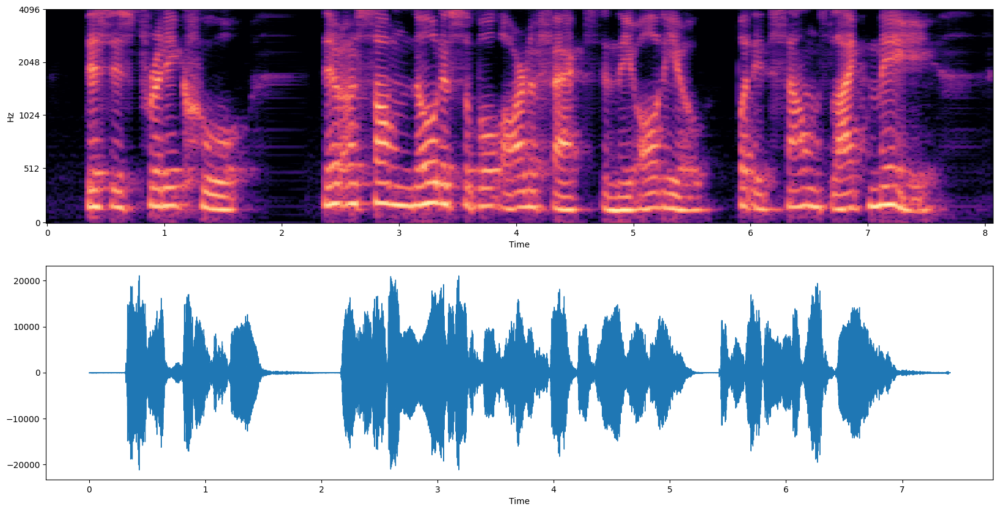

In [ ]:

fd = io.BytesIO(audio_bytes)
clone_sr, clone_data = wavfile.read(fd)

# librosa only accepts f32s
clone_audio = clone_data.astype(np.float32)


fig, ax = plt.subplots(2,1,figsize=(20,10))
plot_melspectrogram(clone_audio, clone_sr, annotations=None, n_mels=256,
                    fmax=4096, fig=fig, ax=ax[0], show_legend=False)
librosa.display.waveshow(clone_audio, sr=clone_sr, ax=ax[1])



Comment on your impressions of the voice clone. Describe differences you hear between the clone and your actual voice. Do you think this quality of clone could convince someone it's actually you?

```
Your response here
WOOW, it really sounds like me, only with some minor distortions and my friends would think it is because of the inaccuracy
of recording device. It is so convincible. scary!

```

### Task: Finding markers of non-human speech in visualizations (5 points)

One way we might reveal that an utterance is from a TTS system rather than real human voice is via visualizing the time-domain and spectrogram plots to find indicators of TTS.

Using an utterance from your voice clone, visualize both the time domain and spectrogram to show any indicators the voice is not human. Adjust your plots by zooming in or anything else you choose.

Describe any indicators you can find that would support a claim that the voice clone utterance does not come from a human. It might help to compare with human-produced utterances from above.

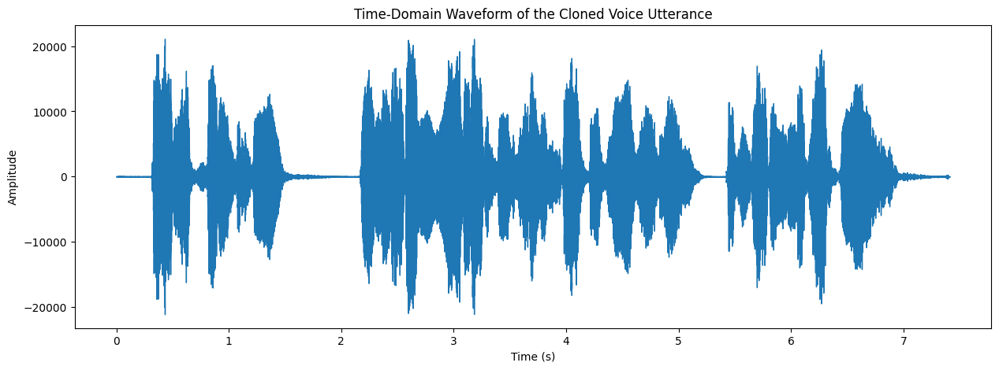

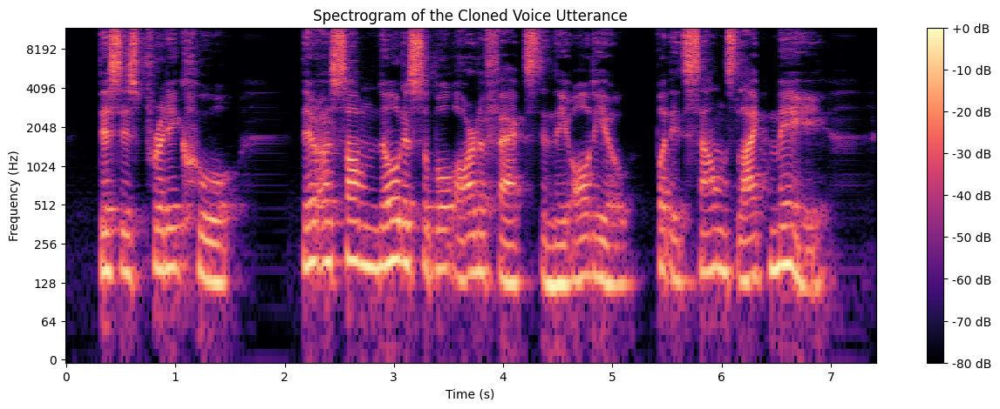

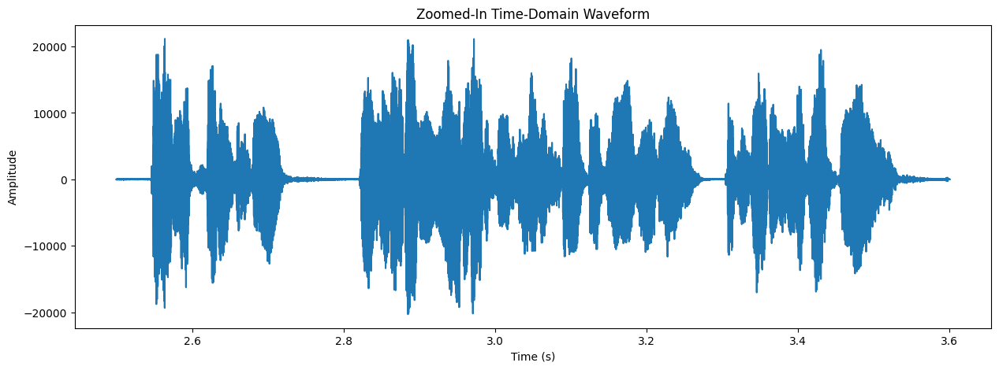

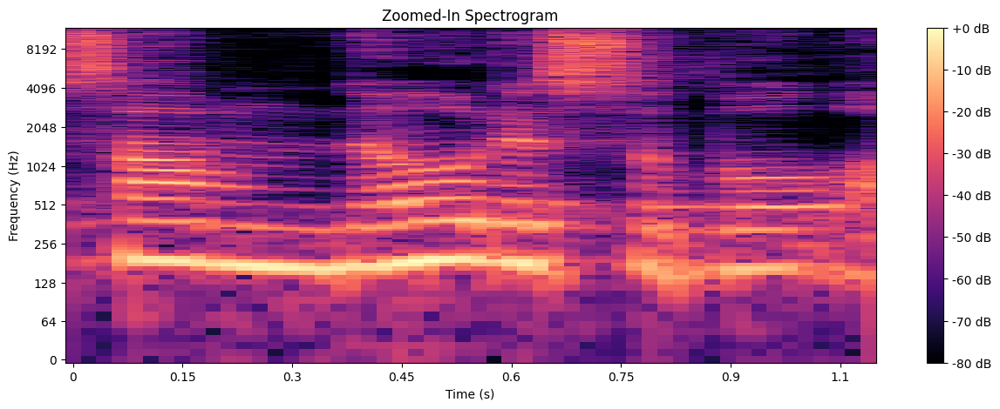

In [ ]:
# Visualize an utterance with both spectrogram and time domain.
# Adjust your plots to show indicators this comes from TTS

#############################
#### YOUR CODE GOES HERE ####

# Play the generated audio
display(Audio(clone_audio, rate=clone_sr))

# Create a plot for the time-domain waveform
plt.figure(figsize=(15, 5))
librosa.display.waveshow(clone_audio, sr=clone_sr)
plt.title('Time-Domain Waveform of the Cloned Voice Utterance')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude')
plt.show()

# Compute and display the spectrogram
n_fft = 2048
hop_length = 512
D = np.abs(librosa.stft(clone_audio, n_fft=n_fft, hop_length=hop_length))
S_db = librosa.amplitude_to_db(D, ref=np.max)

plt.figure(figsize=(15, 5))
librosa.display.specshow(S_db, sr=clone_sr, hop_length=hop_length,
                         x_axis='time', y_axis='log')
plt.colorbar(format='%+2.0f dB')
plt.title('Spectrogram of the Cloned Voice Utterance')
plt.xlabel('Time (s)')
plt.ylabel('Frequency (Hz)')
plt.show()

# Zoom into a specific time frame to check for artifacts
start_time = 2.5  # Adjust to the part we need to change
end_time = 3.6

# Convert time to sample indices
start_sample = int(start_time * clone_sr)
end_sample = int(end_time * clone_sr)

# Extract the relevant audio segment
clone_audio_seg = clone_audio[start_sample:end_sample]

# Plot the focused waveform
plt.figure(figsize=(15, 5))
times = np.linspace(start_time, end_time, len(clone_audio))
plt.plot(times, clone_audio)
plt.title('Zoomed-In Time-Domain Waveform')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude')
plt.show()

# Get the zoomed-in spectrogram
D_segment = np.abs(librosa.stft(clone_audio_seg, n_fft=n_fft, hop_length=hop_length))
S_db_segment = librosa.amplitude_to_db(D_segment, ref=np.max)

plt.figure(figsize=(15, 5))
librosa.display.specshow(S_db_segment, sr=clone_sr, hop_length=hop_length,
                         x_axis='time', y_axis='log')
plt.colorbar(format='%+2.0f dB')
plt.title('Zoomed-In Spectrogram')
plt.xlabel('Time (s)')
plt.ylabel('Frequency (Hz)')
plt.show()



#############################

Describe your findings. What indicators can you find in the visualizations corresponding to non-human speech?


```
Your response here
Indicators of Non-Human Speech:
1.Pitch range: We can see in the zoomed area, non-human sound often show a narrow pitch range. But for human have more varied
pitch of speech.
2. Presence of Noise: cloned speech includes noise-like components, which can be seen in broad spectral energy distribution
3. Unvoiced Segments: Non-human sounds may include segments that are entirely unvoiced, like hisses, and this can be identified
by spectral energy distribution, showing small energy in the lower frequencies

```

## Using Bark

[Bark](https://github.com/suno-ai/bark) is a transformer-based model for generating audio from a text prompt. It's broader than just generating speech, it can generate non-speech noises including environmental sounds or signing. Bark is broad, but it is sometimes difficult to control -- the model may deviate from the prompt.

Let's generate some audio with Bark and compare it with our other TTS systems so far.

### Setup



Before continuing, ensure the notebook runtime is set to T4 GPU

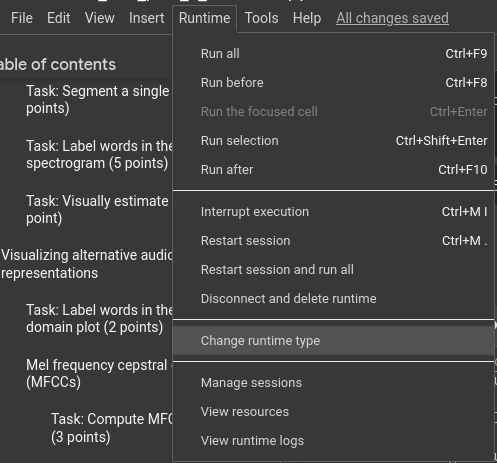

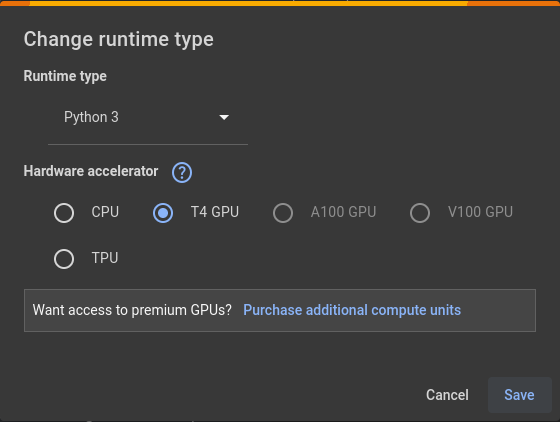

In [ ]:
from transformers import AutoProcessor, BarkModel
processor = AutoProcessor.from_pretrained("suno/bark")
model = BarkModel.from_pretrained("suno/bark").to("cuda")
model.cuda()

voice_preset = "v2/en_speaker_6"


/usr/local/lib/python3.10/dist-packages/huggingface_hub/file_download.py:1150: FutureWarning: `resume_download` is deprecated and will be removed in version 1.0.0. Downloads always resume when possible. If you want to force a new download, use `force_download=True`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:89: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


tokenizer_config.json:   0%|          | 0.00/353 [00:00<?, ?B/s]

speaker_embeddings_path.json:   0%|          | 0.00/61.1k [00:00<?, ?B/s]

vocab.txt:   0%|          | 0.00/996k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/2.92M [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/125 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/8.81k [00:00<?, ?B/s]

pytorch_model.bin:   0%|          | 0.00/4.49G [00:00<?, ?B/s]

/usr/local/lib/python3.10/dist-packages/torch/nn/utils/weight_norm.py:134: FutureWarning: `torch.nn.utils.weight_norm` is deprecated in favor of `torch.nn.utils.parametrizations.weight_norm`.
  WeightNorm.apply(module, name, dim)


generation_config.json:   0%|          | 0.00/4.91k [00:00<?, ?B/s]

The attention mask and the pad token id were not set. As a consequence, you may observe unexpected behavior. Please pass your input's `attention_mask` to obtain reliable results.
Setting `pad_token_id` to `eos_token_id`:10000 for open-end generation.


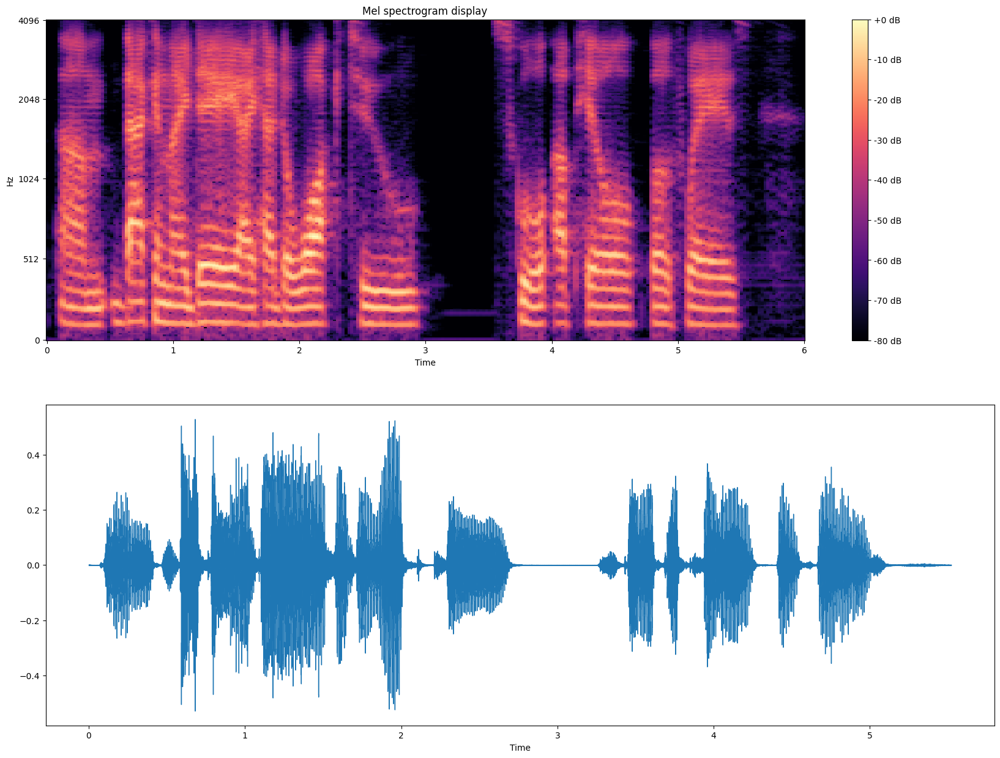

In [ ]:
import librosa
import librosa.display
import matplotlib.pyplot as plt
import numpy as np
from IPython.display import Audio

inputs = processor("Back in my day, I had to walk to school uphill... both ways", voice_preset=voice_preset).to("cuda")

bark_audio_array = model.generate(**inputs)
bark_audio_array = bark_audio_array.cpu().numpy().squeeze()
bark_sr = model.generation_config.sample_rate

# plot the audio
fig, ax = plt.subplots(2,1,figsize=(20,15))
plot_melspectrogram(bark_audio_array, bark_sr, fig=fig, ax=ax[0])
librosa.display.waveshow(bark_audio_array, sr=bark_sr, ax=ax[1])

Audio(data=bark_audio_array, rate=bark_sr)

### Task: Compare to normal TTS systems (3 points)

Use Bark to generate utterances with the same transcript as some of your LMNT or Rime utterances. Visualize the Bark samples you generate as a spectrogram.

Comment on Bark vs traditional TTS approaches. Does Bark sound better as a TTS system in terms of naturalness? Expressiveness? Does Bark always remain faithful to the input transcript? You do not need to perform a full listening test comparison.


The attention mask and the pad token id were not set. As a consequence, you may observe unexpected behavior. Please pass your input's `attention_mask` to obtain reliable results.
Setting `pad_token_id` to `eos_token_id`:10000 for open-end generation.


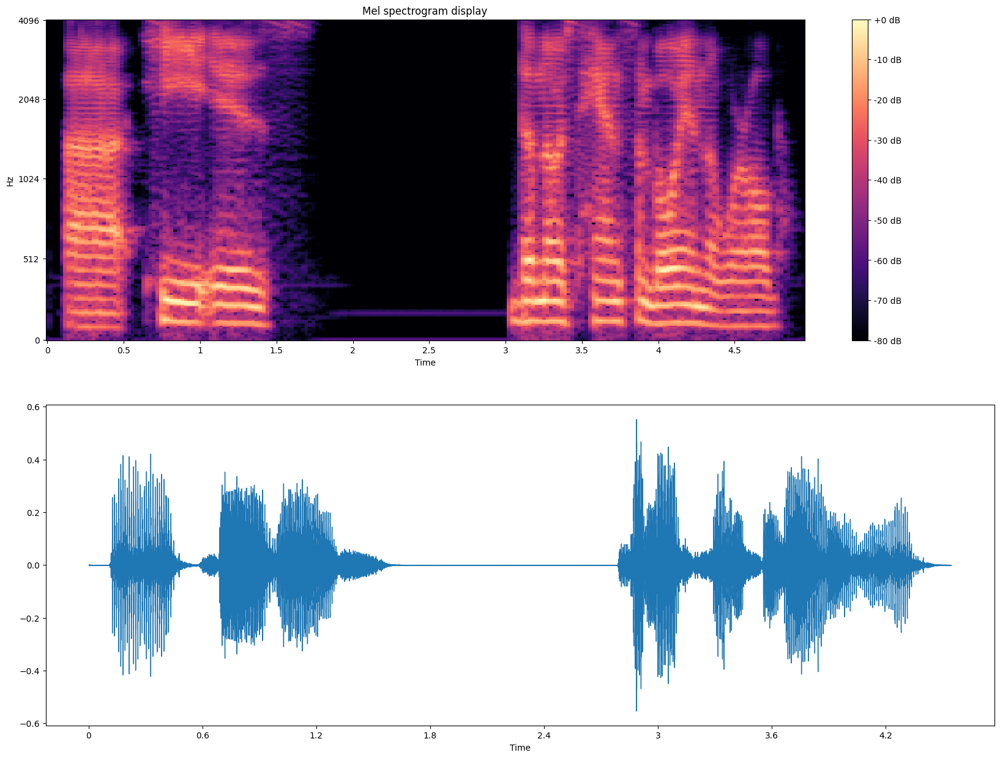

In [ ]:
# Generate at least 1 sample for Bark. Visualize the utterance in a spectrogram
# Comment on Bark vs TTS systems from above

#############################
#### YOUR CODE GOES HERE ####
# define text used in
import librosa
import librosa.display
import matplotlib.pyplot as plt
import numpy as np
from IPython.display import Audio

inputs = processor("He is the most handsome boy in the world.", voice_preset=voice_preset).to("cuda")

bark_audio_array = model.generate(**inputs)
bark_audio_array = bark_audio_array.cpu().numpy().squeeze()
bark_sr = model.generation_config.sample_rate

# plot the audio
fig, ax = plt.subplots(2,1,figsize=(20,15))
plot_melspectrogram(bark_audio_array, bark_sr, fig=fig, ax=ax[0])
librosa.display.waveshow(bark_audio_array, sr=bark_sr, ax=ax[1])

Audio(data=bark_audio_array, rate=bark_sr)

#############################

```
Comment
```
**For naturalness**, the results in  of bark has smoother transitions between phonemes and a more human-like flow and it has obvious pause! While when listening to previous sounds genrated by LMNT, they have monotone qualities and occasionaly it sounds like robotic voice
**For expressiveness**
Bark generally excels in this,  and bark can effectively capture nuances in tone, intonation, and emotion. But as for LMNT, it produces a relativly flat delivery.And it is not easy to tune the sound.

**Not always**, there are instances where the generated speech may diverge slightly,and I guess it is because it misinterprets context or emotion.


### Task: Generate audio that a normal TTS can't produce (2 points)

Bark can do much more than a standard TTS system. Think of an application where you might want a mix of speech and other sounds, or heavily modified prosody. Generate at least one sample with Bark that a normal TTS system would not produce, and describe how Bark might support the application / use case you picked.

/usr/local/lib/python3.10/dist-packages/huggingface_hub/file_download.py:1150: FutureWarning: `resume_download` is deprecated and will be removed in version 1.0.0. Downloads always resume when possible. If you want to force a new download, use `force_download=True`.
  warnings.warn(
The attention mask and the pad token id were not set. As a consequence, you may observe unexpected behavior. Please pass your input's `attention_mask` to obtain reliable results.
Setting `pad_token_id` to `eos_token_id`:10000 for open-end generation.


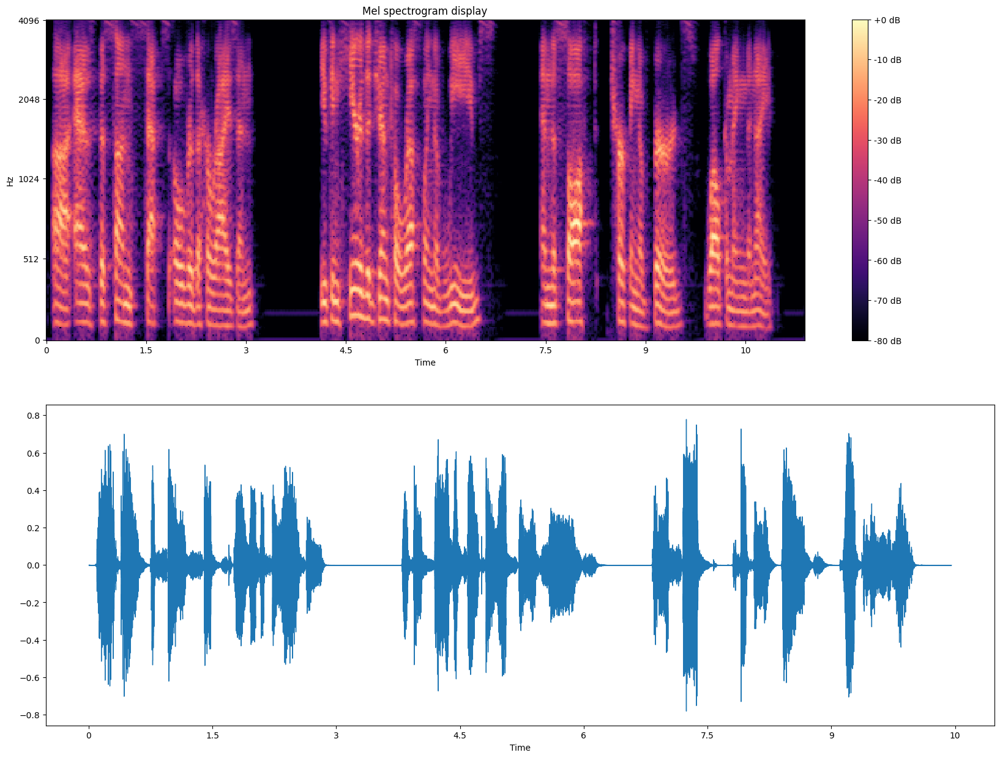

In [ ]:
# Generate at least 1 sample for Bark. Visualize the utterance in a spectrogram
# Comment on applications where you might prefer Bark over traditional TTS

#############################
#### YOUR CODE GOES HERE ####

# Generate an audio sample with mixed sounds
# Define a transcript that includes descriptive sounds
transcript = (
    "As the sun sets over the horizon, you can hear the gentle rustling of leaves, "
    "and the soft chirping of birds welcoming the night."
)

# Generate audio using the Bark model with sound effects
inputs_2 = processor(transcript, voice_preset=voice_preset).to(model.device)

# Generate the audio array
bark_audio_arra_2 = model.generate(**inputs_2)
bark_audio_array_2 = bark_audio_arra_2.cpu().numpy().squeeze()  # Move to CPU and convert to numpy array
bark_sr2 = model.generation_config.sample_rate  # Get the sample rate

# plot the audio
fig, ax = plt.subplots(2,1,figsize=(20,15))
plot_melspectrogram(bark_audio_array_2, bark_sr2, fig=fig, ax=ax[0]) #Fixed typo here
librosa.display.waveshow(bark_audio_array_2, sr=bark_sr2, ax=ax[1]) #Fixed typo here

Audio(data=bark_audio_array_2, rate=bark_sr2) #Fixed typo here


#############################

```
application
```
Bark can be used in creating interactive audiobooks or storytelling experiences that blend speech with sound effects and background audio, providing a richer and more immersive listening experience than traditional text-to-speech (TTS) systems.

Example Scenario: we can add some non-speech sounds in the text.

tanscript = "As the sun sets over the horizon[laughs], you can hear the gentle rustling of leaves, "
and the soft chirping of birds welcoming the night" to get laughs in the middle of the sound.

Or we can use

transcript = """
    ♪ As the sun sets over the horizon[laughs], you can hear the gentle rustling of leaves, and the soft chirping of birds welcoming the night" ♪
"""
 to turn it to a music.

And all this non-speech sounds that a normal TTS system would not be able to produce
Imagine an audiobook where the speaker's voice is mixed with sound effects bird chirpping and rustling sound that correspond to the story. This provides an immersive experience for listeners.

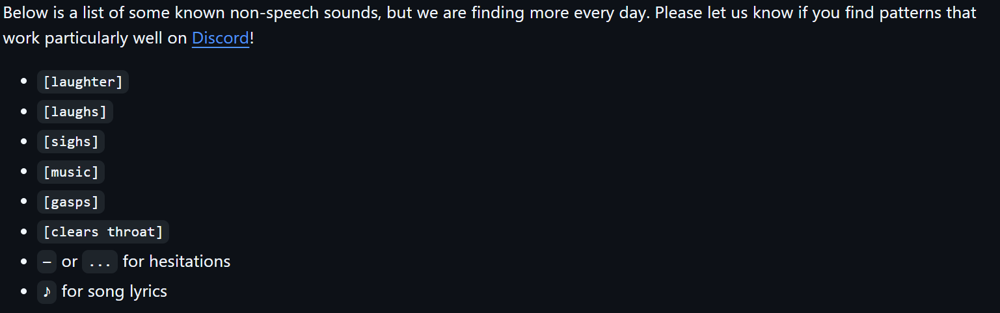

---
# Questions?

Please post on the Ed forum !